# First movement pitcher

### Difference image approach:

* Processing:
    * gray values
    * diff image: one subtracted from the next one
    * smoothed with gaussian filtering
* Different methods:
    * count pixels of difference image above threshold
    * take mean difference --> move if higher threshold
    * if mean difference higher than mean of mean differences (baseline)
    
Too hard to find threshold, to dependend on illumination etc.

### Take 1D gradient of Y coordinates of joints

* take minimum frame of left leg movement and right leg movement
* improvement: take frame only if consequtive frame als has more than threshold gradient (now works for video above as well)
* accuracy around 80%
* Gaussian smoothing used to avoid noise in gradient


* worked on SV and on CF data
* might work really well with better camera and joint output

* false: 15/75, 


###  Neural network real time (sequences)

* train to distinguish between positive (is first movement) and negative (is not first movement) sequences 
* took sequence length of 20 frames, overlapping such that checked every 10th
* test acc for that: 95%
* tested by taking maximum of these outputs
* accuracy if normalized per sequence: 75%
* accuracy if normalized whole pitch: 90%

* sequences of 10 frames: accuracy that ground truth label less than 5 away: 65%

### Neural network all frames

* label one hot vector of 167 --> frame number as output
* accuracy five frames more or less: 93%

### Take release frame into account:

* NN with bins for relase frame: 90% accuracy on first movement moment in range of 5 frames

### WRONG ONES
    
490972-1049b32d-1ca7-4b26-ad1e-e58ad5ad9dc9

490972-f473c66c-0c5b-43b1-b985-b423ccc36bf2

490972-63731b5a-4823-4d0b-933c-70b675f15f69

490972-979c7968-8533-4a2a-bee1-db75f05e0696 

490972-01c36310-b871-4132-9fa7-49d01b56b941

# First movement batter

### gradient method on only one video

2017-05-03/center field/490509-3f640b3f-9ba5-4e89-8f72-97c9f333aa2c.mp4

* Start of the swing: Upper body (shoulders, elbows, wrist) Y coordinate --> moving down during swing
* Start of run: lower body moving to the left --> X coordinate

### Problems:

problem (ALEX): was machem wir mit denen, die anfangen zu rennen aber dann stoppen
    labeled not hit into play, aber fangen an zu rennen
zweites problem: lables hit into play, aber rennen nicht
  

wrong guy detected: 
* 83764a69-2028-4530-8188-f7c37162d403
* 46188b82-c795-42e4-8eb1-db3d616d3b4f
* 889613f9-85f0-4043-864b-f0d486a9816e

# Futher ideas:

* Train on pictures of pitchers with their legs raised
    * +: real time
    * -: still missing out all the Stretch pitcher without raised leg
    * PROBLEM: no labels
 * Use batter side information (left or right handed --> which leg raised --> use only these trajectories
     * "Batter side"
     * "Pitcher throws" ("L" or "R")

# Test v0 output

* show example of json file

In [40]:
import cv2
import numpy as np
import json
import matplotlib.pylab as plt
import time
from os import listdir
coordinates = ["x", "y"]
joints_list = ["right_shoulder", "left_shoulder", "right_elbow", "right_wrist","left_elbow", "left_wrist",
            "right_hip", "right_knee", "right_ankle", "left_hip", "left_knee", "left_ankle", "neck ",
            "right_eye", "right_ear","left_eye", "left_ear"]

In [41]:
def get_filesystem_dic(path, view):
    dic = {}
    for d in listdir(path):
        dic[d] = listdir(path+d+"/"+view)
    return dic

def get_paths_from_games(game_ids, path_videos, view):
    dic = get_filesystem_dic(path_videos, view)
    # print(dic)
    dates_belonging = []
    for g in game_ids:
        print(g)
        if view == "side view":
            new = g+".m4v"
        else:
            new = g+".mp4"
        for key in dic.keys():
            #print(key)
            if new in dic[key]:
                #print("found")
                dates_belonging.append(key)
    # assert(len(game_ids)==len(dates_belonging))
    return dates_belonging[0]

In [38]:
def from_json(file):
    tic = time.time()
    with open(file, 'r') as inf:
        out = json.load(inf)
    position = out["Pitching position"]
    pitchtype = out["Pitch Type"]
    liste = []
    events = {}
    for i, fr in enumerate(out["frames"]):
        l_joints = []
        for j in joints_list[:12]:
            l_coo = []
            for xy in coordinates:
                l_coo.append(fr[j][xy])
            l_joints.append(l_coo)
        if fr["events"]!=[]:
            for eve in fr["events"]:
                events[eve["name"]] = i
        liste.append(l_joints)

    print(time.time()-tic)
    return np.array(liste), events, position, pitchtype

0.010354042053222656
490524-3d1c4681-2808-4148-bb66-38ddda9ed59f
490524-3d1c4681-2808-4148-bb66-38ddda9ed59f
2017-05-04
POSITION:  ['Windup']
PITCH TYPE:  None


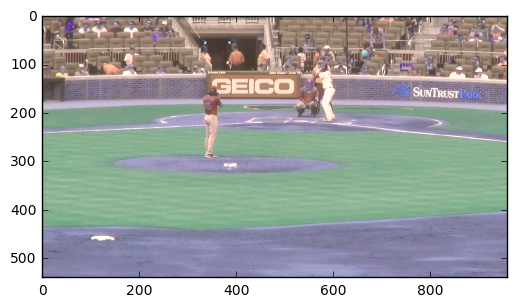

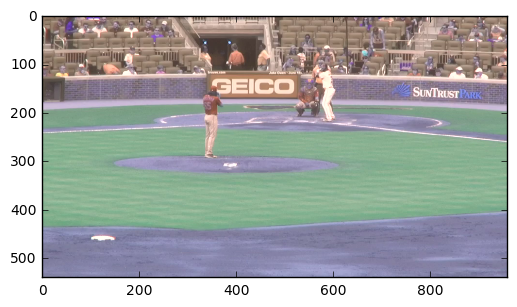

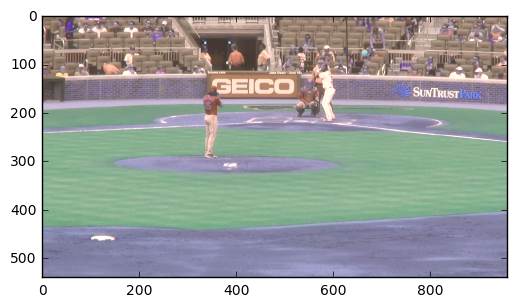

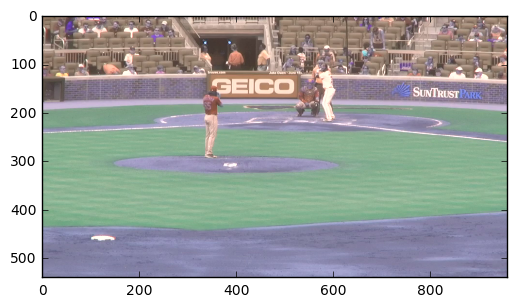

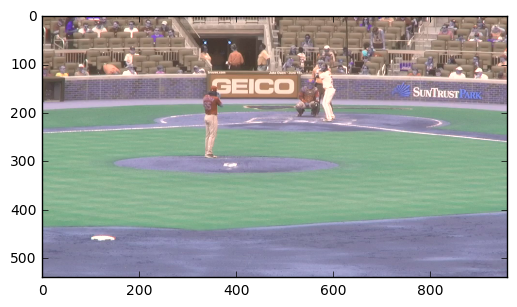

...

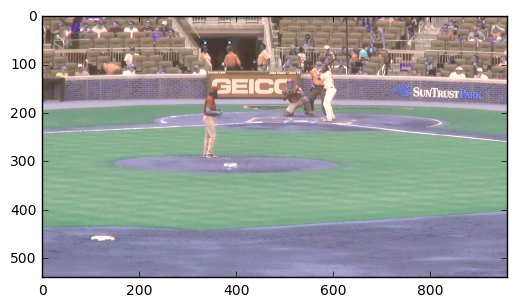

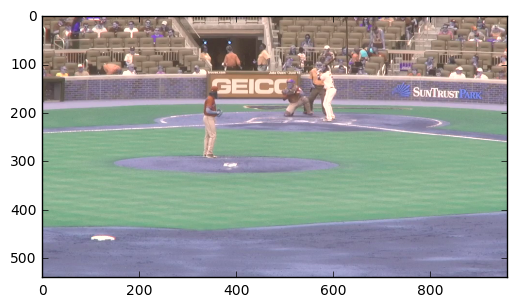

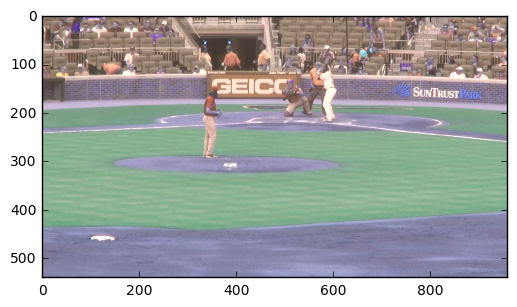

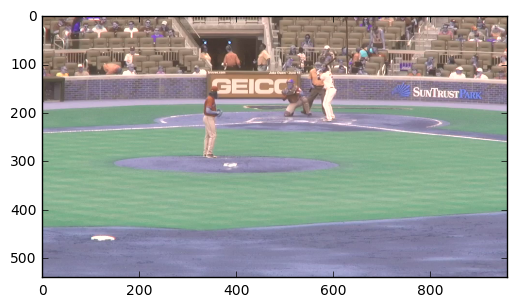

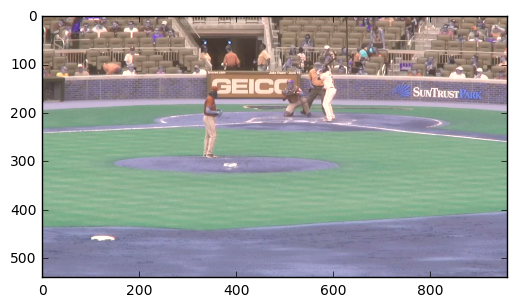

FIRST MOVE


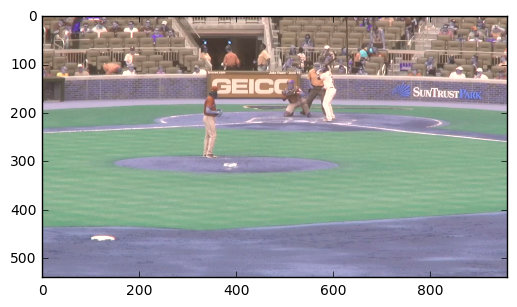

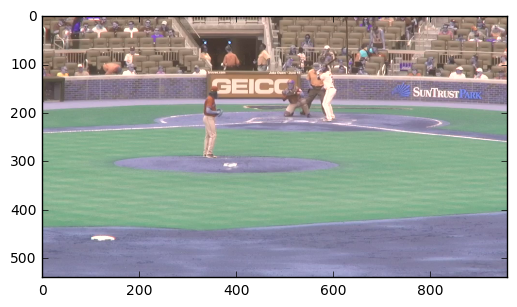

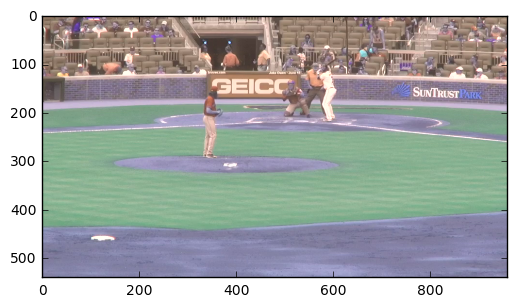

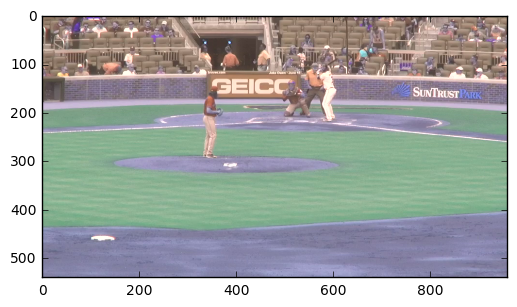

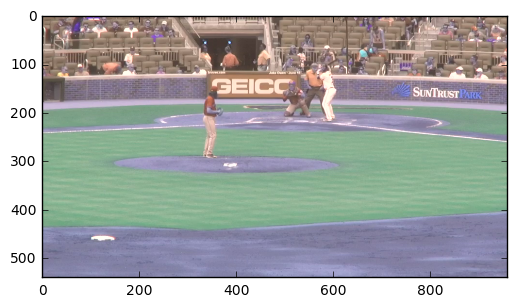

...

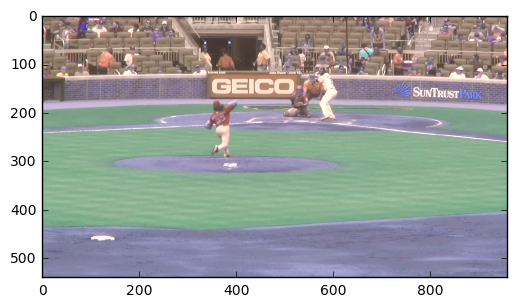

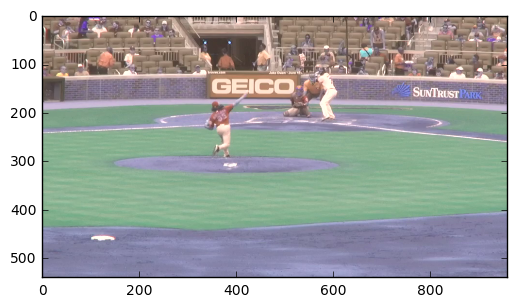

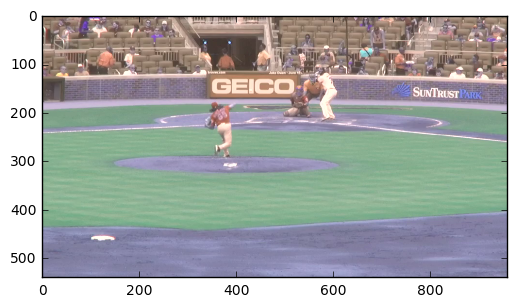

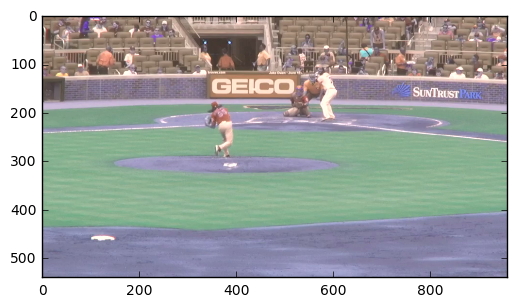

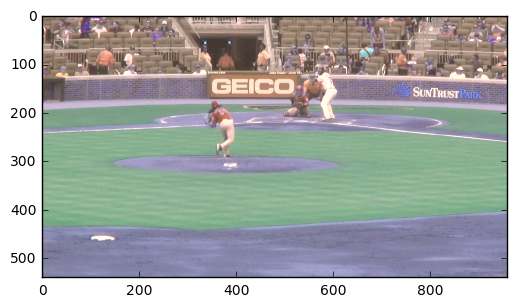

RELEASE FRAME


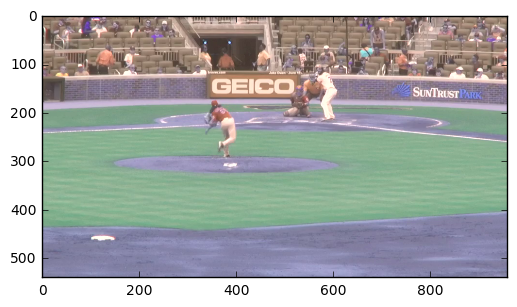

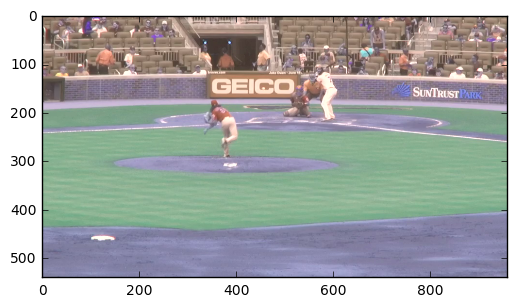

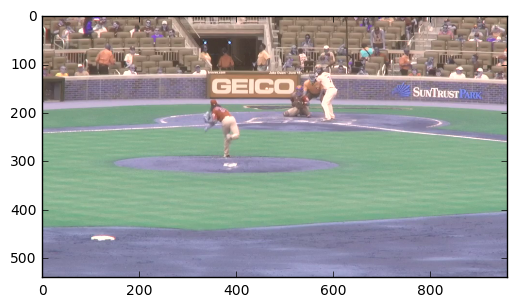

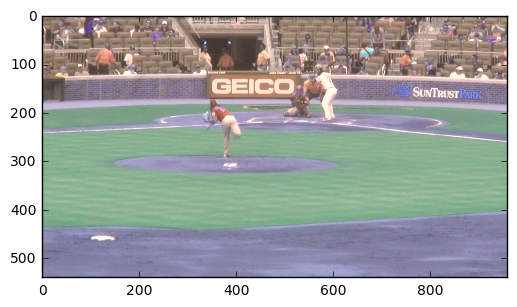

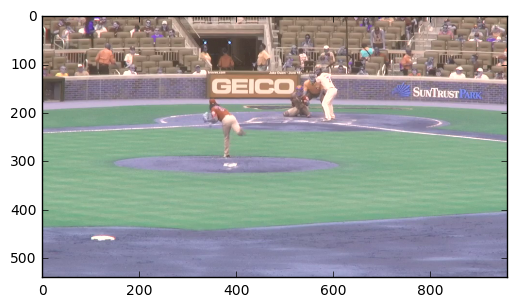

...

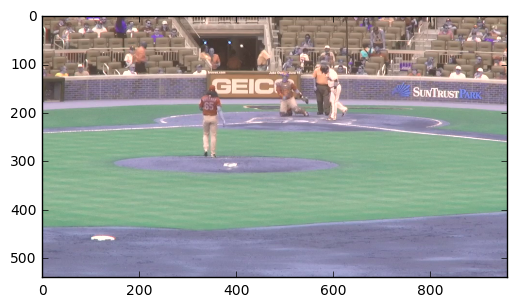

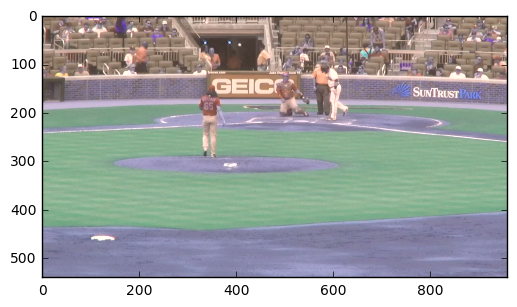

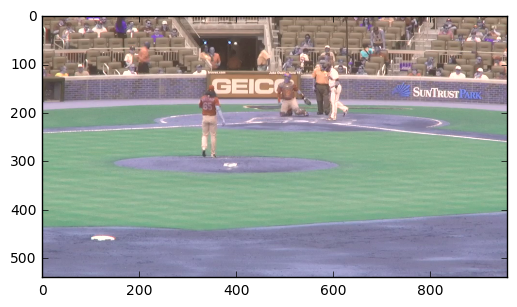

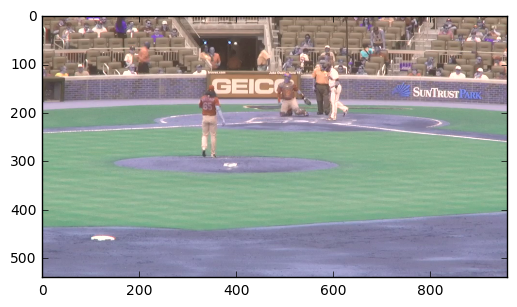

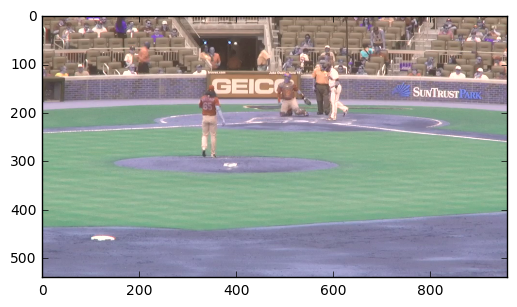

In [51]:
infile = "v0testing/490524-3d1c4681-2808-4148-bb66-38ddda9ed59f_pitcher_joints.json"
# 490524-0de95d55-8dc1-4f0d-9e9d-d0672ff847b3_pitcher_joints.json" zum vorzeigen nehmen 

path_videos = "/Volumes/Nina Backup/videos/atl/"

array, events, position, pitchtype = from_json(infile)
game_id = (infile.split("_")[0]).split("/")[-1]
print(game_id)
date = get_paths_from_games(np.array([game_id]), path_videos, "center field")
print(date)

print("POSITION: ", position)
print("PITCH TYPE: ", pitchtype)

#print(path_videos+date+"/center field/"+game_id+"mp4")
cap = cv2.VideoCapture(path_videos+date+"/center field/"+game_id+".mp4")
i=0
while True:
    ret, frame = cap.read()
    if frame is None:
        break
    if i ==events["first_move"]:
        print("FIRST MOVE")
    if i ==events["release_frame"]:
        print("RELEASE FRAME")
    plt.imshow(frame)
    plt.show()
    i+=1